In [1]:
import sys, os
sys.path.append('python\\plot')

import massPy as mp
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, MovieWriter

from utils import get_frame_number, get_defect_list, get_defect_arr_from_frame, estimate_size_reduction
from plot_utils import *

plt.style.use('sg_article')

In [2]:
path = 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data'

data_dirs = os.listdir(path)
data_dirs = [os.path.join(path, d) for d in data_dirs]
#ar = mp.archive.loadarchive(data_dirs[0])

#### Below we plot a frame from each archive

In [46]:
paths = [data_dirs[7], data_dirs[9], data_dirs[10], data_dirs[11]] #, data_dirs[3]]
act_list = [19, 0.0205, 0.021, 0.022] #, 0.028, 0.06]

paths2 = [data_dirs[3], data_dirs[4], data_dirs[-7]]
act_list2 = [0.019, 0.022, 0.022]

In [173]:
paths

['C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns512_19n16_npz',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns512_205',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns512_21',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns512_22']

In [186]:
path = paths[3]
fn = 3
ar = mp.archive.loadarchive(path)
f = get_frame_number(fn, path, ar.ninfo)
frame = ar._read_frame(f)

LX = ar.LX
LY = ar.LY 
Qxx_dat = frame.QQxx.reshape(LX, LY)
Qyx_dat = frame.QQyx.reshape(LX, LY)

defects = mp.nematic.nematicPy.get_defects(Qxx_dat, Qyx_dat, LX, LY)
S, nx, ny = mp.nematic.nematicPy.get_director(Qxx_dat, Qyx_dat)
charges = mp.nematic.nematicPy.get_charge(Qxx_dat, Qyx_dat, LX, LY)
def_arr = get_defect_arr_from_frame(defects)
charge_arr = np.array([defects[i]['charge'] for i in np.arange(len(defects))])
plus_mask = (charge_arr > 0)

In [174]:
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
def vorticity_abs(frame, engine=plt, vmin=None, vmax=None, abs=False):
    """ Plot the vorticity """
    # vorticity computed with 5-point stencil
    w = mp.base_modules.flow.vorticity(frame)
    w = np.abs(w) if abs else w
    wmax = np.max(np.abs(w))
    # plot using engine
    vmin = None if vmin is None else vmin * wmax
    vmax = None if vmax is None else vmax * wmax

    im = engine.imshow(w.T, cmap='turbo', interpolation='lanczos', origin='lower', vmin= vmin, vmax= vmax)
    # add colorbar
    divider = make_axes_locatable(engine)
    cax = divider.append_axes("right", size="5%", pad="2%")
    plt.colorbar(im, cax)

In [189]:
from itertools import product
def director(frame, engine=plt, scale=False, avg=4, ms = 1, alpha=1, lw=.5):
    """ Plot the director field """
    # get nematic field tensor
    Qxx = frame.QQxx.reshape(frame.LX, frame.LY)
    Qyx = frame.QQyx.reshape(frame.LX, frame.LY)
    # get order S and director (nx, ny)
    S, nx, ny = mp.nematic.nematicPy.get_director(Qxx, Qyx)
    # plot using engine
    x, y = [], []
    for i, j in product(np.arange(frame.LX, step=avg), np.arange(frame.LY, step=avg)):
        f = avg*(S[i,j] if scale else 1.)
        x.append(i - f*nx[i,j]/2.)
        x.append(i + f*nx[i,j]/2.)
        x.append(None)
        y.append(j - f*ny[i,j]/2.)
        y.append(j + f*ny[i,j]/2.)
        y.append(None)
    engine.plot(x, y, color='k', linestyle='-', markersize=1, linewidth=lw, alpha=alpha)

def order(frame, engine=plt, vmin=None):
    """ Plot the order """
    # get order S
    S, _, _ = mp.nematic.nematicPy.get_director(frame.QQxx, frame.QQyx)
    S = S.reshape(frame.LX, frame.LY)
    # plot using engine
    Smax = np.max(np.abs(S))
    # plot using engine
    vmin = np.min(Smax) if vmin is None else vmin
    im = engine.imshow(S.T, cmap='turbo', interpolation='lanczos', origin='lower', alpha=.85, clim=(vmin, min(1,Smax)))
    # add colorbar
    divider = make_axes_locatable(engine)
    cax = divider.append_axes("right", size="5%", pad="2%")
    cbar = plt.colorbar(im, cax)

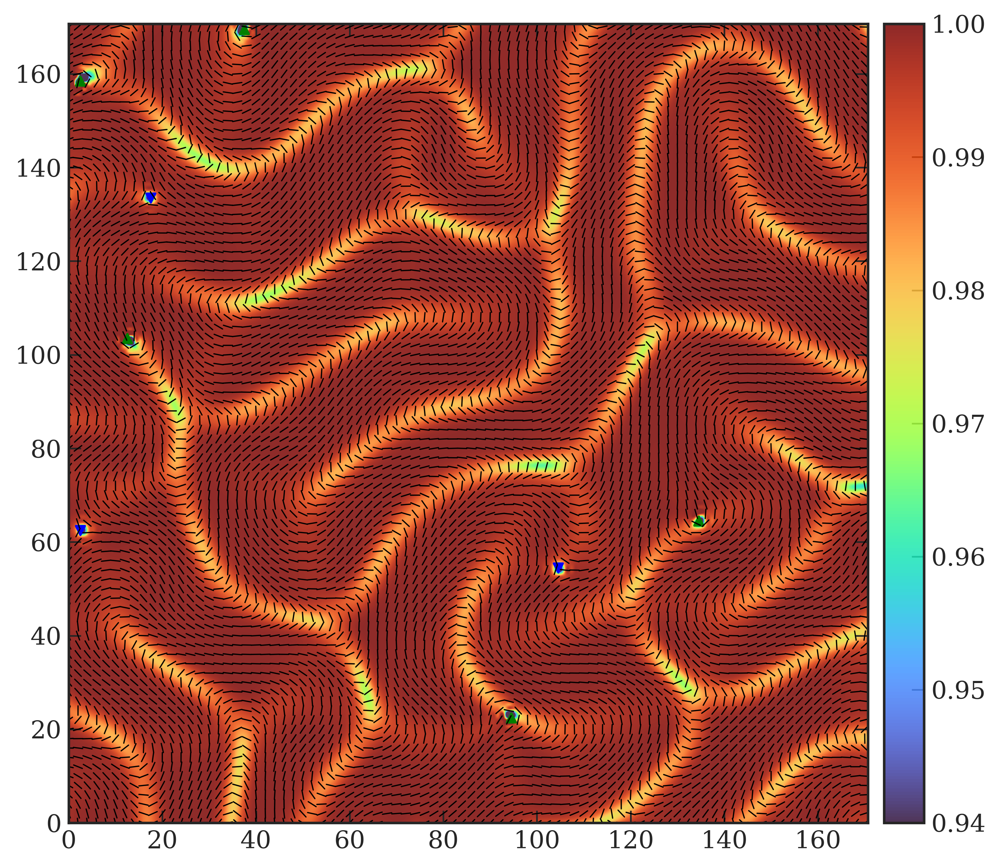

In [193]:
fig,ax = plt.subplots()
director(frame,ax, avg=2, ms =.8, lw=.6)
order(frame,ax, vmin=0.94)
ax.scatter(def_arr[plus_mask, 0], def_arr[plus_mask, 1], c='g', alpha=1,marker='^', s=20)
ax.scatter(def_arr[~plus_mask, 0], def_arr[~plus_mask, 1], c='b', alpha=1,marker='v', s=20)   
ax.set_aspect('equal')
ax.set(xlim=[0,LX/3], ylim=[0,LY/3]);

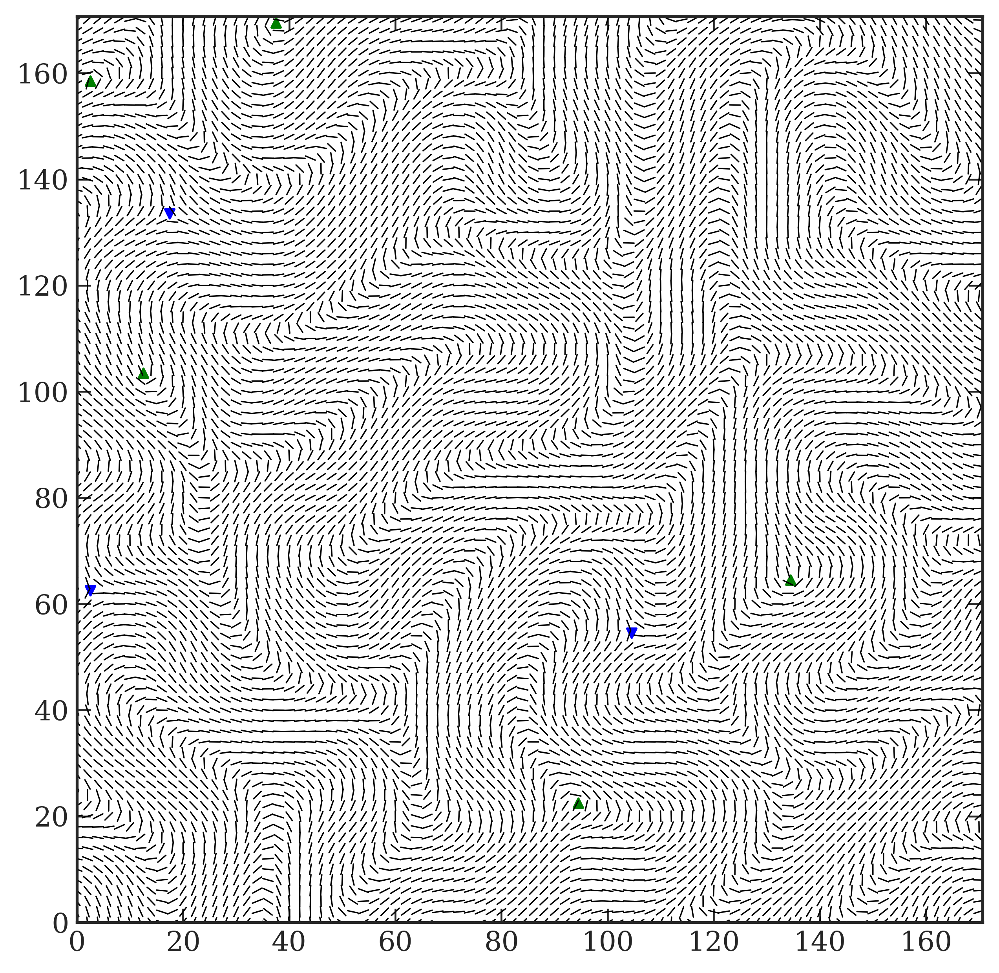

In [191]:
fig,ax = plt.subplots()
director(frame,ax, avg=2, ms =.8, lw=.6)
#order(frame,ax, vmin=0.94)
ax.scatter(def_arr[plus_mask, 0], def_arr[plus_mask, 1], c='g', alpha=1,marker='^', s=16)
ax.scatter(def_arr[~plus_mask, 0], def_arr[~plus_mask, 1], c='b', alpha=1,marker='v', s=16)   
ax.set_aspect('equal')
ax.set(xlim=[0,LX/3], ylim=[0,LY/3]);

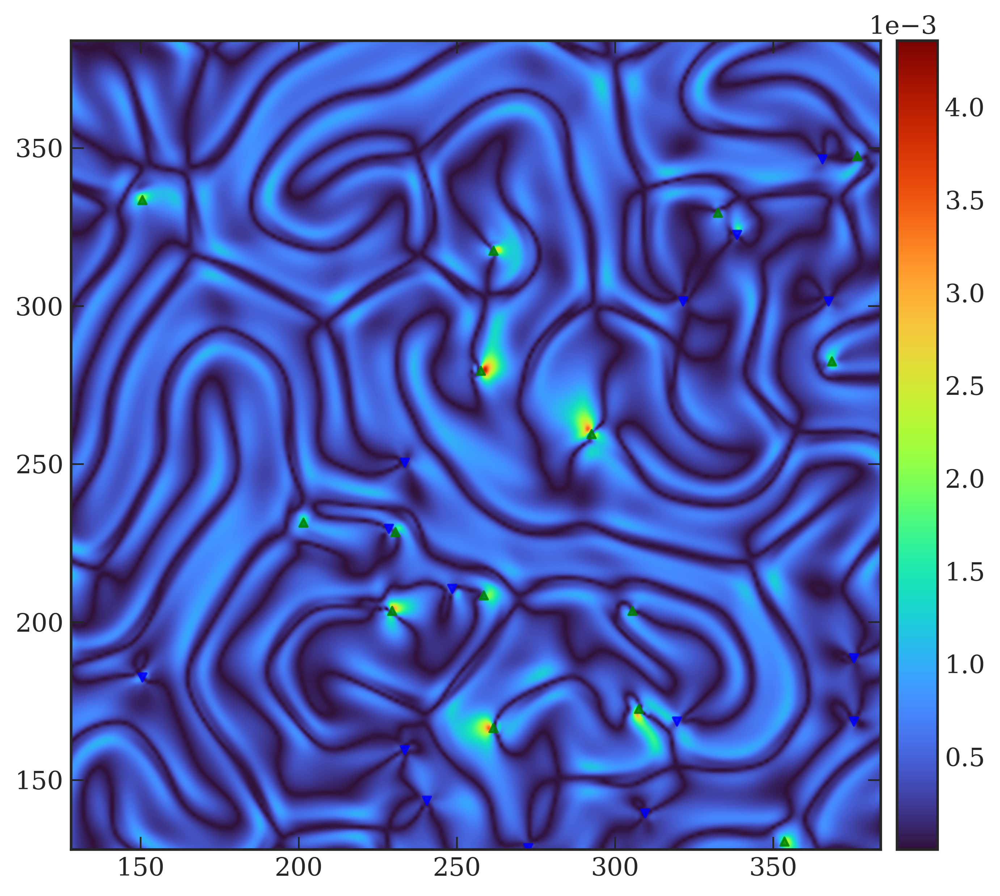

In [112]:
fig, ax = plt.subplots()
vorticity_abs(frame, ax, abs=True)
#mp.nematic.plot.vorticity(frame, ax)
#mp.nematic.plot.defects(frame, ax)
ax.scatter(def_arr[plus_mask, 0], def_arr[plus_mask, 1], c='g', alpha=.8,marker='^', s=15)
ax.scatter(def_arr[~plus_mask, 0], def_arr[~plus_mask, 1], c='b', alpha=.8,marker='v', s=15)
ax.set_aspect('equal')
ax.set(xlim=[LX/4,3*LX/4], ylim=[LX/4,3*LX/4],);   

In [114]:
data_dirs

['C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\compressed_data',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns1024_06',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns1024_06_npz',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns256_1n0_compressed',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns256_22n0_compressed',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns512_06_npz',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns512_19n16',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns512_19n16_npz',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns512_19n3',
 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuni

In [ ]:
fig, ax = plt.subplots(nrows=1,ncols=3,figsize=(15,5))
ax = ax.flatten()
for i, path in enumerate(paths2):
    
    fn = 3
    ar = mp.archive.loadarchive(path)
    f = get_frame_number(fn, path, ar.ninfo)
    frame = ar._read_frame(f)
    ax[i].set_title(f'Activity = {act_list2[i]}')

    LX = ar.LX
    LY = ar.LY 
    Qxx_dat = frame.QQxx.reshape(LX, LY)
    Qyx_dat = frame.QQyx.reshape(LX, LY)
    
    #defects = mp.nematic.nematicPy.get_defects(Qxx_dat, Qyx_dat, LX, LY)
    #print(f"Ndefects for act = {act_list[i]}: ", len(defects))

    ms = 3 if i == 3 else 4
    alpha = .8 if i == 3 else 1
    avg = 2
    
    for row in range(ax.shape[0]):
        ax[i].xaxis.set_ticks_position('none') 
        ax[i].yaxis.set_ticks_position('none')
        ax[i].set_aspect('equal')  
        ax[i].set(xlim=[LX/3,2*LX/3], ylim=[LX/3,2*LX/3]); 
        mp.nematic.plot.defects(frame, ax[i], ms = ms, alpha=alpha)
    
    mp.nematic.plot.director(frame, ax[i], ms = .8, lw=1.2, avg=avg)
   # mp.nematic.plot.velocity(frame, ax[1, i], avg=4)

    #mp.nematic.plot.defects(frame, ax[0, i], ms = ms,)
#ax = ax.T
fig.text(0.25, 0.96, '-1/2', fontsize=14, verticalalignment='bottom', color='blue', fontweight='bold')
fig.text(0.74, 0.96, '+1/2',fontsize=14, verticalalignment='bottom', color='green', fontweight='bold');

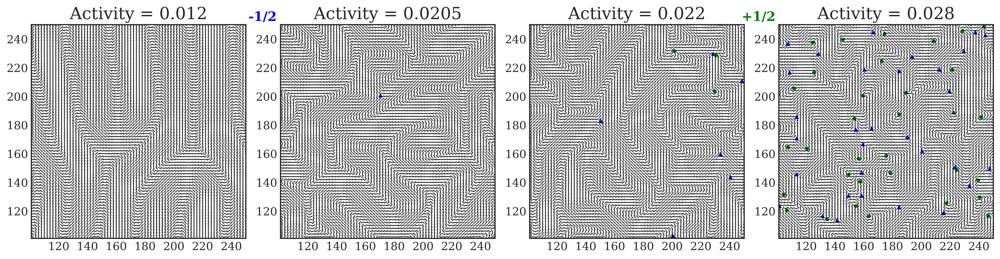

In [170]:


fig, ax = plt.subplots(ncols=4,figsize=(15,4))
ax = ax.flatten()
for i, path in enumerate(paths2):
    
    fn = 3
    ar = mp.archive.loadarchive(path)
    f = get_frame_number(fn, path, ar.ninfo)
    frame = ar._read_frame(f)
    ax[i].set_title(f'Activity = {act_list2[i]}')

    LX = ar.LX
    LY = ar.LY 
    Qxx_dat = frame.QQxx.reshape(LX, LY)
    Qyx_dat = frame.QQyx.reshape(LX, LY)
    
    #defects = mp.nematic.nematicPy.get_defects(Qxx_dat, Qyx_dat, LX, LY)
    #print(f"Ndefects for act = {act_list[i]}: ", len(defects))

    ms = 3
    alpha = 1
    avg = 2
    ms_dir, lw_dir = .8,1
    #ms_dir, lw_dir = .7,.7

    Lstart = 101
    Lend = 250
    xticks=range(Lstart + 19, Lend, 20)

    
    for row in range(ax.shape[0]):
        ax[i].xaxis.set_ticks_position('none') 
        ax[i].yaxis.set_ticks_position('none')
        ax[i].set_aspect('equal')  
       # ax[i].set(xlim=[LX/denom,numerator*LX/denom], ylim=[LX/denom,numerator*LX/denom]); 
        ax[i].set(xlim=[Lstart,Lend], ylim=[Lstart,Lend], xticks=xticks, yticks=xticks); 
        mp.nematic.plot.defects(frame, ax[i], ms = ms, alpha=alpha)

    
    mp.nematic.plot.director(frame, ax[i], ms = ms_dir, lw=lw_dir, avg=avg, alpha=.8)
   # mp.nematic.plot.velocity(frame, ax[1, i], avg=4)

    #mp.nematic.plot.defects(frame, ax[0, i], ms = ms,)
#ax = ax.T

fig.text(0.25, 0.9, '-1/2', fontsize=14, verticalalignment='bottom', color='blue', fontweight='bold')
fig.text(0.74, 0.9, '+1/2',fontsize=14, verticalalignment='bottom', color='green', fontweight='bold');
fig.tight_layout()
fig.dpi= 720

In [142]:
paths = [data_dirs[7], data_dirs[9], data_dirs[10], data_dirs[11]] #, data_dirs[3]]
act_list = [19, 0.0205, 0.021, 0.022] #, 0.028, 0.06]

paths2 = [data_dirs[-3], data_dirs[9], data_dirs[-5], data_dirs[-4]]
act_list2 = [0.012, 0.0205, 0.022, 0.028]

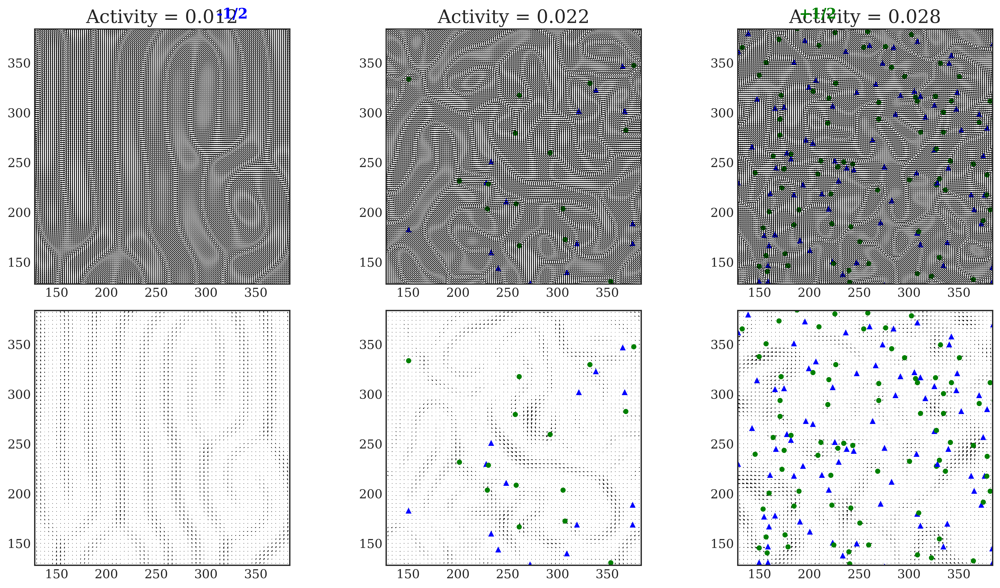

In [126]:
fig, ax = plt.subplots(nrows=2,ncols=4,figsize=(16,8))
for i, path in enumerate(paths):
    
    fn = 3
    ar = mp.archive.loadarchive(path)
    f = get_frame_number(fn, path, ar.ninfo)
    frame = ar._read_frame(f)
    ax[0,i].set_title(f'Activity = {act_list[i]}')

    LX = ar.LX
    LY = ar.LY 
    Qxx_dat = frame.QQxx.reshape(LX, LY)
    Qyx_dat = frame.QQyx.reshape(LX, LY)
    
    #defects = mp.nematic.nematicPy.get_defects(Qxx_dat, Qyx_dat, LX, LY)
    #print(f"Ndefects for act = {act_list[i]}: ", len(defects))

    ms = 3 if i == 3 else 4
    alpha = .8 if i == 3 else 1
    avg = 4
   
    
    for row in range(ax.shape[0]):
        ax[row, i].xaxis.set_ticks_position('none') 
        ax[row, i].yaxis.set_ticks_position('none')
        ax[row,i].set_aspect('equal')  
      #  ax[row,i].set(xlim=[LX/4,3*LX/4], ylim=[LX/4,3*LX/4]); 
        mp.nematic.plot.defects(frame, ax[row, i], ms = ms, alpha=alpha)
    
    mp.nematic.plot.director(frame, ax[0, i], ms = .5, lw=.7, avg=avg)
    mp.nematic.plot.velocity(frame, ax[1, i], avg=4)

    #mp.nematic.plot.defects(frame, ax[0, i], ms = ms,)
#ax = ax.T
fig.text(0.25, 0.96, '-1/2', fontsize=14, verticalalignment='bottom', color='blue', fontweight='bold')
fig.text(0.74, 0.96, '+1/2',fontsize=14, verticalalignment='bottom', color='green', fontweight='bold');

#### Below we plot N frames from a given archive

In [4]:
path = data_dirs[-9]
act = .019
Nframes = len(os.listdir(path)) - 1
Njump = 1
ar = mp.archive.loadarchive(path)

In [ ]:
plot_frames(ar, path, save = False)

#### Animate N frames from a given archive

In [7]:
def frame_plotter(frame, plot_director = True,  ms = 4, engine = plt):
    """Plot a frame. If plot_director is False, the velocity field is plotted instead.
    
    Example usage:
    
    plotter = lambda frame, engine: frame_plotter(frame, plot_director = False, engine = engine)
    animate(ar, plotter, rng=[0, Nframes], inter=1000, show=False, save=True);
    
    """
    
    # set plotting params 
    plt.tick_params(
    axis='both',          # changes apply to both axes
    which='both',      # both major and minor ticks are affected
    bottom=False,  
    left=False,
    right=False,       
    top=False,      
    labelbottom=False) 

    if plot_director:
        mp.nematic.plot.director(frame, engine)
        mp.nematic.plot.defects(frame, ms = ms, engine = engine) 
    else:
        mp.nematic.plot.velocity(frame, engine)
        mp.nematic.plot.defects(frame, ms = ms, engine = engine) 
    return


In [ ]:
Nframes = len([i for i in os.listdir(path) if i.startswith('frame')])
plotter = lambda frame, engine: frame_plotter(frame, plot_director = False, ms = 4, engine = engine)
animate(ar, plotter, rng=[0, Nframes], inter=2000, show=False, save=True);

In [10]:
print("Animation size (MB):", os.path.getsize('anim_L512_zeta0.019.mp4') / 1024 ** 2)

Animation size (MB): 27.996668815612793
